# Evolution of the Upper Vegetation Limit in the Lötschen Valley (Final analysis notebook)

*SGG.00425: Data and methods for environmental analysis*

Author: Bart Kevin, Bosson Zoélie, Rey Thomas. Assisted by: Prof. POHL Eric & Prof. MACHGUTH Horst  

Date: November 6, 7, 13 and 14, 2025

## Importing necessary libraries

In [13]:
# We need to import the sdc_utilities from the custom src folder
import sys                              # for system-specific parameters and functions
sys.path.append(r'../src')              # add custom source directory to system path
from sdc_utilities import *             # import all utilities from sdc_utilities module

# Standard libraries
import numpy as np                      # for numerical operations  
import xarray as xr                     # for handling multi-dimensional arrays
import pandas as pd                     # for data manipulation and analysis
import matplotlib.pyplot as plt         # for plotting
import matplotlib.dates as mdates       # for handling dates in plots
import ipywidgets as widgets            # for interactive widgets in Jupyter notebooks
from IPython.display import display, clear_output
import pickle                           # for object serialization

# Plotly libraries
import plotly.graph_objects as go       # for interactive plotting
import plotly.colors as pc              # for color utilities
import plotly.express as px             # for easy plotting
from plotly.subplots import make_subplots  # for creating subplot layouts

from pystac_client import Client        # for STAC API client
from shapely.geometry import Polygon    # for geometric objects
from odc.stac import stac_load          # for loading data from STAC
from pyproj import Proj, transform      # for coordinate transformations
from odc import loader                  # for data loading utilities
import odc                              # Open Data Cube utilities    

# Optional libraries
# import time                             # for measuring execution time
# import pyproj                           # for coordinate reference systems and transformations
# import psutil                           # for system and process utilities
# import dask.distributed                 # for parallel computing
# import rioxarray                        # for raster data handling with xarray
# import ast                              # for parsing strings into Python objects

# Silence warning (not recommended during development)
import warnings                         # to manage warnings
warnings.filterwarnings("ignore")       # ignore all warnings

## Analysis of the final dataset

In [3]:
dataset_final = xr.open_dataset(r"..\data\processed\dataset_final_1984_2025.nc")

In [6]:
dataset_final

<xarray.Dataset> Size: 252MB
Dimensions:        (time: 40, y: 454, x: 495)
Coordinates:
  * time           (time) datetime64[ns] 320B 1984-09-02T09:40:47 ... 2025-08...
  * y              (y) float64 4kB 1.148e+06 1.148e+06 ... 1.134e+06 1.134e+06
  * x              (x) float64 4kB 2.622e+06 2.622e+06 ... 2.637e+06 2.637e+06
    spatial_ref    int32 4B 2056
Data variables:
    blue           (time, y, x) float32 36MB ...
    green          (time, y, x) float32 36MB ...
    red            (time, y, x) float32 36MB ...
    nir            (time, y, x) float32 36MB ...
    red_corrected  (time, y, x) float32 36MB ...
    nir_corrected  (time, y, x) float32 36MB ...
    NDVI           (time, y, x) float32 36MB ...

### Plot the red, NIR and NDVI for a selected date

Dropdown(description='Date:', index=39, options=(('1984-09-02T09:40:47', 0), ('1985-07-10T09:46:52', 1), ('198…

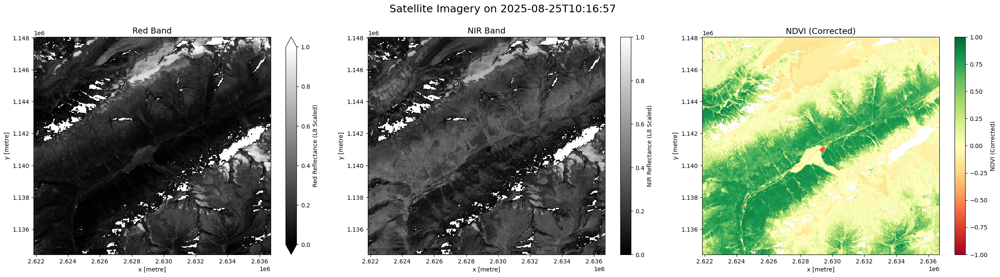

In [ ]:
# Widget dropdown
dates_dropdown = widgets.Dropdown(
    options=[(str(d)[:19], i) for i, d in enumerate(dataset_final['time'].values)],
    description='Date:',
    value=0
)
print("You can select a date from the dropdown menu to update the plots.")
display(dates_dropdown)

# Function to update the plot based on the selected date
def update_plot(change):
    clear_output(wait=True)  # Clear the previous plot
    display(dates_dropdown)  # Redisplay the widget
    date_index_to_plot = change["new"]

    sample_red = dataset_final['red_corrected'].isel(time=date_index_to_plot)
    sample_nir = dataset_final['nir_corrected'].isel(time=date_index_to_plot)
    sample_ndvi = dataset_final['NDVI'].isel(time=date_index_to_plot)
    date_format = str(dataset_final['time'][date_index_to_plot].values)[:19]
    
    plt.figure(figsize=(24, 6))

    # --- 1. Plot of the band Red
    ax1 = plt.subplot(131)
    sample_red.plot.imshow(ax=ax1, cmap='gray', vmin=0.0, vmax=1.0, robust=True,
        cbar_kwargs={'label': 'Red Reflectance (L8 Scaled)'}
    )
    ax1.set_title(f"Red Band", fontsize=14)
    ax1.set_aspect('equal')

    # --- 2. Plot of the NIR band
    ax2 = plt.subplot(132)
    sample_nir.plot.imshow(ax=ax2, cmap='gray', vmin=0.0, vmax=1.0, robust=True,
        cbar_kwargs={'label': 'NIR Reflectance (L8 Scaled)'}
    )
    ax2.set_title(f"NIR Band", fontsize=14)
    ax2.set_aspect('equal')

    # --- 3. Plot of the NDVI
    ax3 = plt.subplot(133)
    sample_ndvi.plot.imshow(ax=ax3, cmap='RdYlGn', vmin=-1.0, vmax=1.0, robust=True,
        cbar_kwargs={'label': 'NDVI (Corrected)'}
    )
    ax3.set_title(f"NDVI (Corrected)", fontsize=14)
    ax3.set_aspect('equal')

    # Add a title to the entire figure
    plt.suptitle(f"Satellite Imagery on {date_format}", fontsize=18, y=1.03)

    plt.tight_layout()
    # Save the figure, this can take some time be patient
    # plt.savefig(r"..\figures\red_nir_ndvi_" + date_format.replace(":", "-") + ".png", dpi=300, bbox_inches='tight')
    plt.show()

# Run the update function
dates_dropdown.observe(update_plot, names="value")

### Plot the RGB for all dates in the dataset

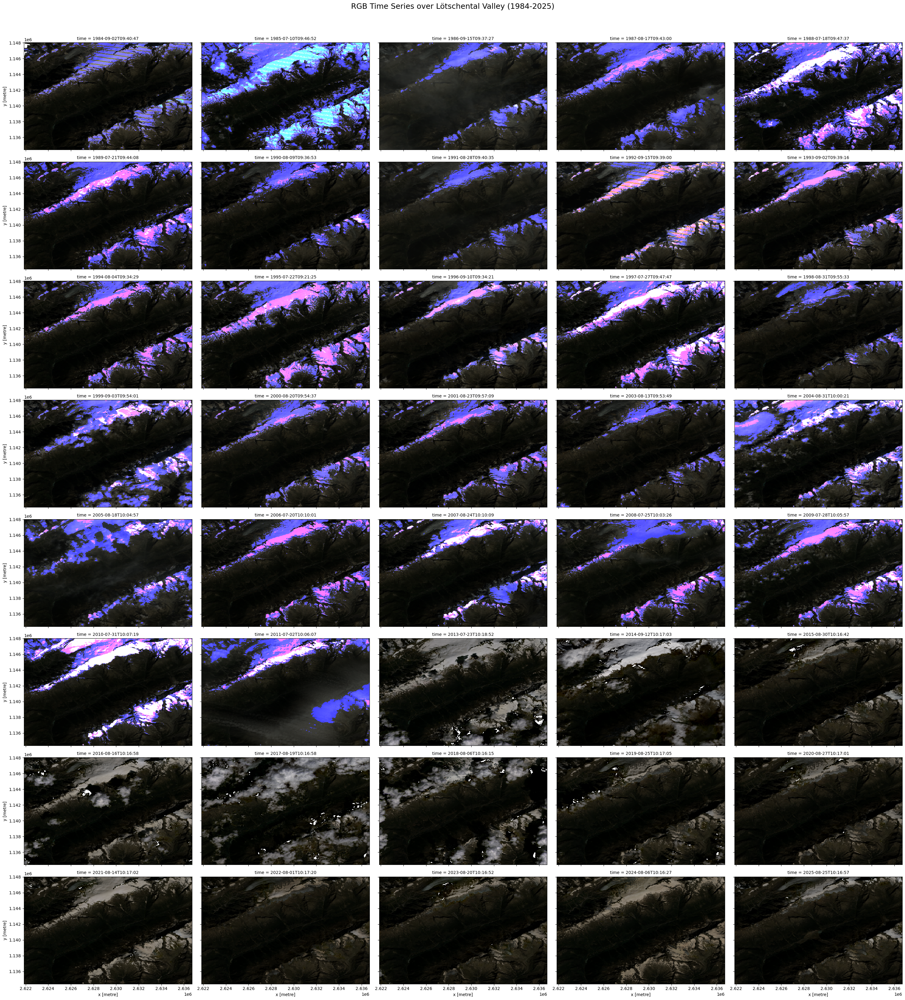

In [ ]:
ncols = 5                            
nrows = int(np.ceil(len(dataset_final['time']) / ncols))
subplot_width = 6                           
subplot_height = 4                              
figsize = (subplot_width * ncols, subplot_height * nrows)

g = dataset_final[['red','green','blue']].to_array().plot.imshow(
    col='time',
    col_wrap=ncols,
    robust=True,
    figsize=figsize
)

# Add a title to the entire figure
g.fig.suptitle("RGB Time Series over Lötschental Valley (1984-2025)", fontsize=18, y=1.03)

# Save the figure
# plt.savefig(r"..\figures\landsat5_8_timeseries_1984_2025_rgb.png", dpi=600, bbox_inches='tight')

### Plot NDVI for all dates in the dataset

Text(0.5, 1.03, 'Corrected NDVI Time Series over Lötschental Valley (1984-2025)')

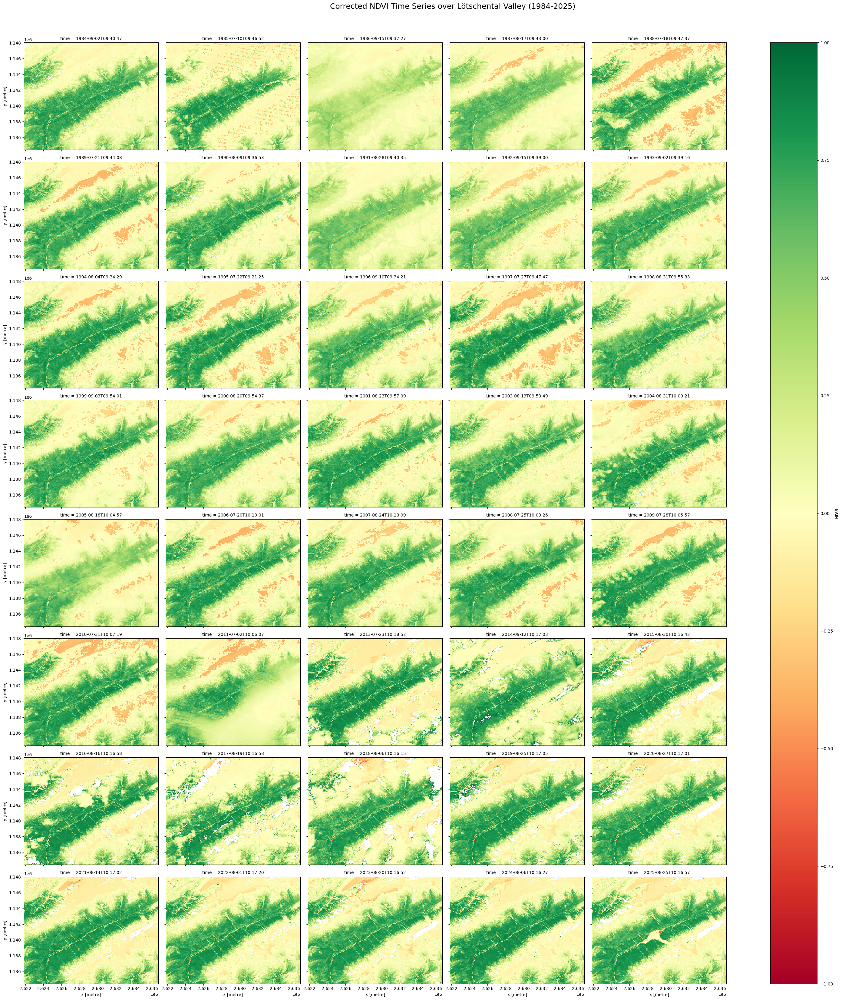

In [6]:
ncols = 5                            
nrows = int(np.ceil(len(dataset_final['time']) / ncols))
subplot_width = 6                           
subplot_height = 4                              
figsize = (subplot_width * ncols, subplot_height * nrows)

g = dataset_final['NDVI'].plot.imshow(
    col='time',
    col_wrap=ncols,
    vmin=-1.0,
    vmax=1.0,
    robust=True,
    cmap='RdYlGn',
    figsize=figsize
)

# Add a title to the entire figure
g.fig.suptitle("Corrected NDVI Time Series over Lötschental Valley (1984-2025)", fontsize=18, y=1.03)

# Save the figure
# plt.savefig(r"..\figures\landsat5_8_timeseries_1984_2025_ndvi.png", dpi=600, bbox_inches='tight')

## Analysis of the NDVI

In [9]:
with open(r"..\data\processed\altitude_bins_south_200.pkl", "rb") as f:
    altitude_bins_south = pickle.load(f)

with open(r"..\data\processed\altitude_bins_north_200.pkl", "rb") as f:
    altitude_bins_north = pickle.load(f)

In [10]:
def compute_ndvi_means(altitude_bins, dataset_final, filter_ndvi=True):
    """
    Calcule la moyenne du NDVI pour chaque bande d'altitude et chaque date.
    
    altitude_bins : dictionnaire { (zmin, zmax) : DataFrame des points }
    dataset_final : xarray.Dataset avec NDVI(time, y, x)
    filter_ndvi : bool, si True, ignore les valeurs NDVI <0 ou >1
    """
    
    xs = dataset_final.x.values
    ys = dataset_final.y.values

    # Vérifier si y est inversé
    if ys[0] > ys[-1]:
        ys = ys[::-1]
        dataset_final = dataset_final.reindex(y=ys)

    results = []

    for (zmin, zmax), df_points in altitude_bins.items():
        Xp = df_points["X"].values
        Yp = df_points["Y"].values

        # --- Filtrer points hors raster ---
        mask_valid = (Xp >= xs.min()) & (Xp <= xs.max()) & (Yp >= ys.min()) & (Yp <= ys.max())
        Xp = Xp[mask_valid]
        Yp = Yp[mask_valid]

        if len(Xp) == 0:
            # Aucune donnée dans la bande
            for t in dataset_final.time.values:
                results.append({
                    "time": pd.to_datetime(str(t)),
                    "zmin": float(zmin),
                    "zmax": float(zmax),
                    "NDVI_mean": np.nan
                })
            continue

        # --- Indices raster ---
        ix = np.searchsorted(xs, Xp) - 1
        iy = np.searchsorted(ys, Yp) - 1

        mask_ok = (ix >= 0) & (ix < len(xs)) & (iy >= 0) & (iy < len(ys))
        ix = ix[mask_ok]
        iy = iy[mask_ok]

        if len(ix) == 0:
            for t in dataset_final.time.values:
                results.append({
                    "time": pd.to_datetime(str(t)),
                    "zmin": float(zmin),
                    "zmax": float(zmax),
                    "NDVI_mean": np.nan
                })
            continue

        # --- Calcul de la moyenne pour chaque date ---
        for t in dataset_final.time.values:
            ndvi_map = dataset_final["NDVI"].sel(time=t).values
            ndvi_values = ndvi_map[iy, ix]

            # Retirer NaN
            ndvi_values = ndvi_values[~np.isnan(ndvi_values)]

            # Filtrer NDVI hors [0,1] si demandé
            if filter_ndvi:
                ndvi_values = ndvi_values[(ndvi_values >= 0) & (ndvi_values <= 1)]

            ndvi_mean = float(ndvi_values.mean()) if len(ndvi_values) > 0 else np.nan

            results.append({
                "time": pd.to_datetime(str(t)),
                "zmin": float(zmin),
                "zmax": float(zmax),
                "NDVI_mean": ndvi_mean
            })

    return pd.DataFrame(results)


In [11]:
df_ndvi_north = compute_ndvi_means(altitude_bins_north, dataset_final)
df_ndvi_south = compute_ndvi_means(altitude_bins_south, dataset_final)

In [12]:
# Merge nord et sud par bande et date
df_merge = pd.merge(
    df_ndvi_north,
    df_ndvi_south,
    on=["time", "zmin", "zmax"],
    suffixes=("_north", "_south")
)

# Calculer la différence NDVI
df_merge["NDVI_diff"] = df_merge["NDVI_mean_north"] - df_merge["NDVI_mean_south"]

In [16]:
# Couleurs en format RGB
light_green = 'rgb(144, 238, 144)'   # lightgreen
dark_green  = 'rgb(0, 100, 0)'       # darkgreen
light_brown = 'rgb(210, 180, 140)'   # tan
dark_brown  = 'rgb(139, 69, 19)'     # saddlebrown

bands = sorted(altitude_bins_south.keys(), key=lambda x: x[0])
n_bands = len(bands)

# Création des palettes
green_palette = pc.n_colors(light_green, dark_green, max(1, n_bands // 2), colortype='rgb')
brown_palette = pc.n_colors(light_brown, dark_brown, n_bands - len(green_palette), colortype='rgb')

# Palette finale bas→haut
colors = green_palette + brown_palette

fig = go.Figure()

for i, (zmin, zmax) in enumerate(bands):

    df_band = df_ndvi_north[
        (df_ndvi_north.zmin == float(zmin)) &
        (df_ndvi_north.zmax == float(zmax))
    ]

    if df_band.empty:
        continue

    df_band_valid = df_band[(df_band["NDVI_mean"] >= 0) & (df_band["NDVI_mean"] <= 1)]
    if df_band_valid.empty:
        continue

    fig.add_trace(go.Scatter(
        x=df_band_valid["time"],
        y=df_band_valid["NDVI_mean"],
        mode="lines+markers",
        line=dict(color=colors[i]),
        marker=dict(color=colors[i]),
        name=f"{int(zmin)}–{int(zmax)} m"
    ))

fig.update_layout(
    title="NDVI evolution per altitude band (South Face)",
    xaxis_title="Time",
    yaxis_title="Mean NDVI",
    hovermode="x unified",
    template="plotly_white",
    legend_title="Altitude Bands"
)

fig.show()

In [ ]:
# Couleurs en format RGB
light_green = 'rgb(144, 238, 144)'   # lightgreen
dark_green  = 'rgb(0, 100, 0)'       # darkgreen
light_brown = 'rgb(210, 180, 140)'   # tan
dark_brown  = 'rgb(139, 69, 19)'     # saddlebrown

bands = sorted(altitude_bins_north.keys(), key=lambda x: x[0])
n_bands = len(bands)

# Création des palettes
green_palette = pc.n_colors(light_green, dark_green, max(1, n_bands // 2), colortype='rgb')
brown_palette = pc.n_colors(light_brown, dark_brown, n_bands - len(green_palette), colortype='rgb')

# Palette finale bas→haut
colors = green_palette + brown_palette

fig = go.Figure()

for i, (zmin, zmax) in enumerate(bands):

    df_band = df_ndvi_north[
        (df_ndvi_north.zmin == float(zmin)) &
        (df_ndvi_north.zmax == float(zmax))
    ]

    if df_band.empty:
        continue

    df_band_valid = df_band[(df_band["NDVI_mean"] >= 0) & (df_band["NDVI_mean"] <= 1)]
    if df_band_valid.empty:
        continue

    fig.add_trace(go.Scatter(
        x=df_band_valid["time"],
        y=df_band_valid["NDVI_mean"],
        mode="lines+markers",
        line=dict(color=colors[i]),
        marker=dict(color=colors[i]),
        name=f"{int(zmin)}–{int(zmax)} m"
    ))

fig.update_layout(
    title="NDVI evolution per altitude band (North Face)",
    xaxis_title="Time",
    yaxis_title="Mean NDVI",
    hovermode="x unified",
    template="plotly_white",
    legend_title="Altitude Bands"
)

fig.show()


In [17]:
# --- Définition des couleurs ---
light_green = 'rgb(144, 238, 144)'   # lightgreen
dark_green  = 'rgb(0, 100, 0)'       # darkgreen
light_brown = 'rgb(210, 180, 140)'   # tan
dark_brown  = 'rgb(139, 69, 19)'     # saddlebrown

# --- Tri des bandes ---
bands = sorted(altitude_bins_north.keys(), key=lambda x: x[0])
n_bands = len(bands)

# --- Palettes ---
green_palette = pc.n_colors(light_green, dark_green, max(1, n_bands // 2), colortype='rgb')
brown_palette = pc.n_colors(light_brown, dark_brown, n_bands - len(green_palette), colortype='rgb')
colors = green_palette + brown_palette

# --- Création des deux sous-figures ---
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=("South", "North"),
    shared_yaxes=True
)

# -------------------------
#      COURBES SOUTH
# -------------------------
for i, (zmin, zmax) in enumerate(bands):

    df_band = df_ndvi_south[
        (df_ndvi_south.zmin == float(zmin)) &
        (df_ndvi_south.zmax == float(zmax))
    ]

    df_band_valid = df_band[
        (df_band["NDVI_mean"] >= 0) & (df_band["NDVI_mean"] <= 1)
    ]

    if df_band_valid.empty:
        continue

    fig.add_trace(
        go.Scatter(
            x=df_band_valid["time"],
            y=df_band_valid["NDVI_mean"],
            mode="lines+markers",
            line=dict(color=colors[i]),
            marker=dict(color=colors[i]),
            name=f"{int(zmin)}–{int(zmax)} m"
        ),
        row=1, col=1
    )

# -------------------------
#      COURBES NORTH
# -------------------------
for i, (zmin, zmax) in enumerate(bands):

    df_band = df_ndvi_north[
        (df_ndvi_north.zmin == float(zmin)) &
        (df_ndvi_north.zmax == float(zmax))
    ]

    df_band_valid = df_band[
        (df_band["NDVI_mean"] >= 0) & (df_band["NDVI_mean"] <= 1)
    ]

    if df_band_valid.empty:
        continue

    fig.add_trace(
        go.Scatter(
            x=df_band_valid["time"],
            y=df_band_valid["NDVI_mean"],
            mode="lines+markers",
            line=dict(color=colors[i]),
            marker=dict(color=colors[i]),
            showlegend=(i==0),  # éviter double légende
            name=f"{int(zmin)}–{int(zmax)} m"
        ),
        row=1, col=2
    )

# --- Mise en forme ---
fig.update_layout(
    title="NDVI evolution per altitude band — South vs North",
    xaxis_title="Time",
    yaxis_title="Mean NDVI",
    hovermode="x unified",
    template="plotly_white",
    legend_title="Altitude bands",
    width=1100,
    height=500
)

fig.show()


In [21]:
# --- Préparation des données ---
df_plot = (
    df_ndvi_north
    .groupby(["time", "zmin"])["NDVI_mean"]
    .mean()
    .reset_index()
    .sort_values(["time", "zmin"])
)

# Toutes les dates uniques triées
dates = sorted(df_plot["time"].unique())

# Palette
colors = px.colors.sample_colorscale("Viridis", [i/len(dates) for i in range(len(dates))])

# --- Figure ---
fig = go.Figure()

for color, date in zip(colors, dates):
    subset = df_plot[df_plot["time"] == date]

    fig.add_trace(go.Scatter(
        x=subset["zmin"],
        y=subset["NDVI_mean"],
        mode="lines+markers",
        name=str(date),
        line=dict(color=color),
        marker=dict(color=color)
    ))

fig.update_layout(
    title="NDVI mean vs altitude — North",
    xaxis_title="Altitude (m)",
    yaxis_title="Mean NDVI",
    hovermode="x unified",
    template="plotly_white",
    legend_title="Date"
)

fig.show()

In [20]:
# --- Préparation des données ---
df_plot = (
    df_ndvi_south
    .groupby(["time", "zmin"])["NDVI_mean"]
    .mean()
    .reset_index()
    .sort_values(["time", "zmin"])
)

# Toutes les dates uniques triées
dates = sorted(df_plot["time"].unique())

# Palette
colors = px.colors.sample_colorscale("Viridis", [i/len(dates) for i in range(len(dates))])

# --- Figure ---
fig = go.Figure()

for color, date in zip(colors, dates):
    subset = df_plot[df_plot["time"] == date]

    fig.add_trace(go.Scatter(
        x=subset["zmin"],
        y=subset["NDVI_mean"],
        mode="lines+markers",
        name=str(date),
        line=dict(color=color),
        marker=dict(color=color)
    ))

fig.update_layout(
    title="NDVI mean vs altitude — South",
    xaxis_title="Altitude (m)",
    yaxis_title="Mean NDVI",
    hovermode="x unified",
    template="plotly_white",
    legend_title="Date"
)

fig.show()

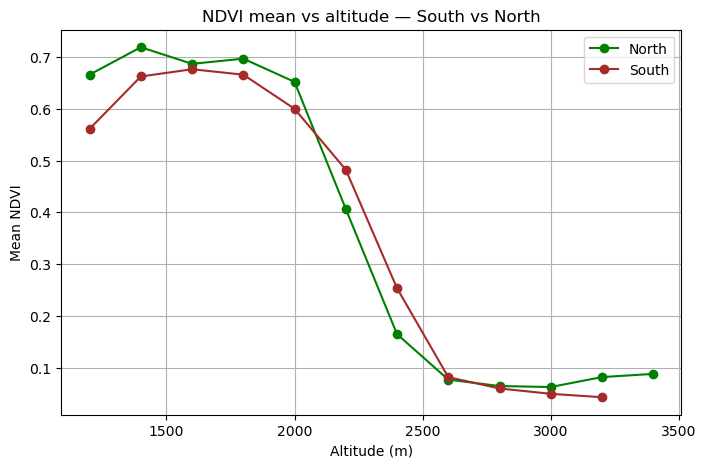

In [18]:
# --- Calcul de la moyenne et de l'écart-type par altitude ---
df_stats_north = df_ndvi_north.groupby("zmin")["NDVI_mean"].agg(["mean", "std"]).reset_index()
df_stats_south = df_ndvi_south.groupby("zmin")["NDVI_mean"].agg(["mean", "std"]).reset_index()

# --- Figure ---
plt.figure(figsize=(8,5))

# North
plt.errorbar(
    df_stats_north["zmin"], 
    df_stats_north["mean"], 
    fmt='-o',            
    color='green', 
    ecolor='green',       # même couleur que la courbe
    elinewidth=2, 
    capsize=4,
    label='North'
)

# South
plt.errorbar(
    df_stats_south["zmin"], 
    df_stats_south["mean"], 
    fmt='-o',
    color='brown',
    ecolor='brown',       # même couleur que la courbe
    elinewidth=2,
    capsize=4,
    label='South'
)

plt.xlabel("Altitude (m)")
plt.ylabel("Mean NDVI")
plt.title("NDVI mean vs altitude — South vs North")
plt.legend()
plt.grid(True)
plt.show()